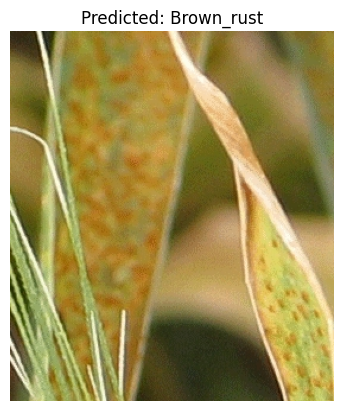

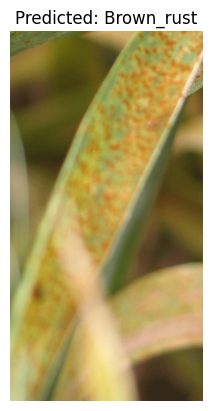

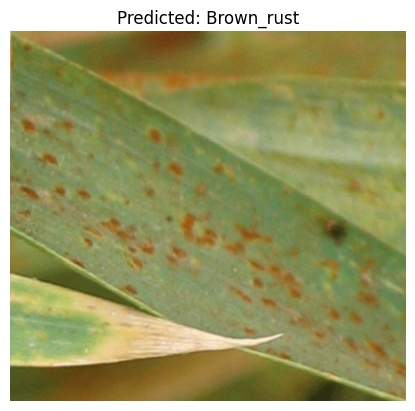

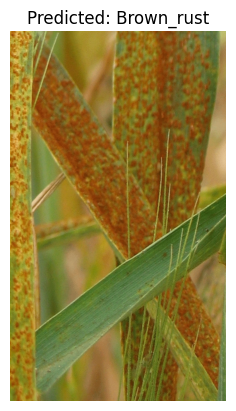

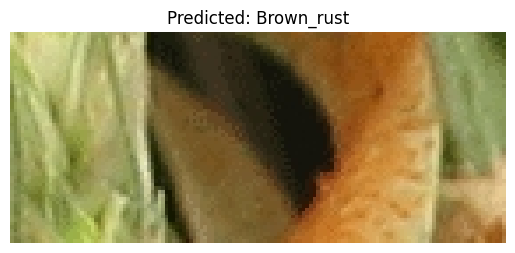

...

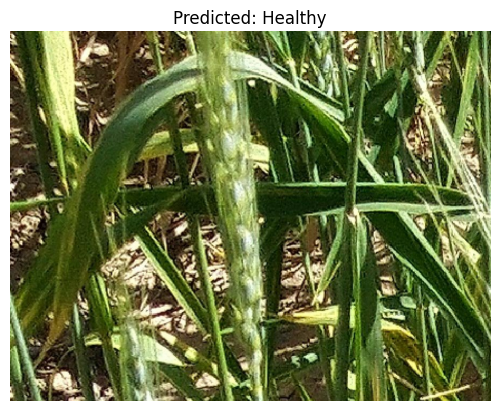

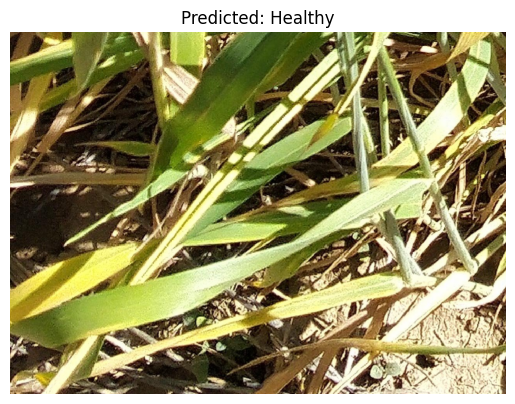

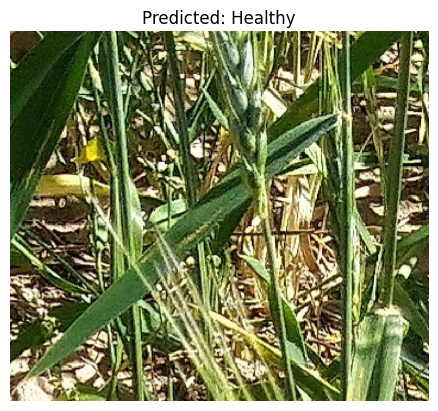

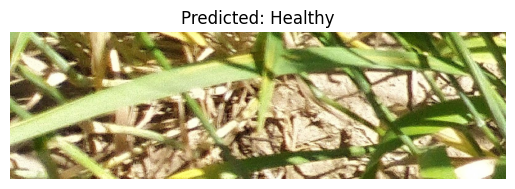

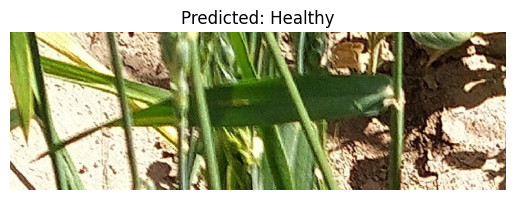

In [1]:
from pathlib import Path
from typing import List
from PIL import Image
import torch
import torchvision
import matplotlib.pyplot as plt
from torch import nn
import os

def remove_digits(s):
    return ''.join([char for char in s if not char.isdigit()])
def get_file_paths(directory: str, file_extension: str = "*") -> List[Path]:
    dir_path = Path(directory)
    file_paths = list(dir_path.glob(f"**/*{file_extension}"))

    return file_paths

def pred_and_store_with_visualization(paths: List[Path],
                                      model: torch.nn.Module,
                                      transform: torchvision.transforms,
                                      class_names: List[str]) -> List[str]:
    device = "cpu"
    predictions = []

    # Обрабатываем каждое изображение в списке путей
    for path in paths:
        img = Image.open(path).convert("RGB")
        transformed_image = transform(img).unsqueeze(0).to(device)

        model.to(device)
        model.eval()

        # Производим инференс
        with torch.inference_mode():
            pred_logit = model(transformed_image)
            pred_prob = torch.softmax(pred_logit, dim=1)
            pred_label = torch.argmax(pred_prob, dim=1)
            pred_class = class_names[pred_label.cpu()]

        predictions.append(pred_class)

        # Визуализация изображения с подписью класса
        plt.imshow(img)
        plt.title(f"Predicted: {pred_class}")
        plt.axis('off')  # Отключаем оси для красоты
        plt.show()

    return predictions


# Метод создания архитектуры обученной модели
def create_effnetb0_model(num_classes: int = 2,
                          seed: int = 42):
    # Получаем дефолтные веса от фреймворка
    weights = torchvision.models.EfficientNet_B6_Weights.DEFAULT

    # Подключаем трансформер изображений согласно полученной структуре
    transforms = weights.transforms()

    # Создаем модель с дефолтными весами
    model = torchvision.models.efficientnet_b6(weights=weights)

    # Замораживаем базовые слои с нейронами
    for param in model.parameters():
        param.requires_grad = False

    # Подключаем мануальный seed для весов, чтобы иметь повторяемость событий
    torch.manual_seed(seed)

    # Заменяем оригинальное количество классов на искомое в нашей задаче
    model.classifier = nn.Sequential(
        nn.Dropout(p=0.2, inplace=True),
        nn.Linear(in_features=2304, out_features=num_classes),
    )

    # Возвращаем полученную модель и трасформеры
    return model, transforms

class_names = ['Brown_rust', 'Healthy']
# Пример использования
extras_dir = "../Check/test/test1"
file_paths = get_file_paths(extras_dir, ".jpg")  # для файлов с расширением '.jpg'
model, model_transforms = create_effnetb0_model(num_classes=2)
model.load_state_dict(torch.load("../models/kt6.pth", weights_only=True, map_location=torch.device("cpu")))
# Запускаем инференс и визуализацию для всех изображений
effnet_test_pred_dicts = pred_and_store_with_visualization(paths=file_paths,
                                                           model=model,
                                                           transform=model_transforms,
                                                           class_names=class_names)



In [2]:
from pathlib import Path
from typing import List
from PIL import Image
import torch
import torchvision
from torch import nn

def remove_digits(s):
    return ''.join([char for char in s if not char.isdigit()])

def get_file_paths(directory: str, file_extension: str = "*") -> List[Path]:
    dir_path = Path(directory)
    file_paths = list(dir_path.glob(f"**/*{file_extension}"))
    return file_paths

def pred_and_store(paths: List[Path],
                   model: torch.nn.Module,
                   transform: torchvision.transforms,
                   class_names: List[str]) -> List[str]:
    device = "cpu"
    predictions = []

    # Обрабатываем каждое изображение в списке путей
    for path in paths:
        img = Image.open(path).convert("RGB")
        transformed_image = transform(img).unsqueeze(0).to(device)

        model.to(device)
        model.eval()

        # Производим инференс
        with torch.inference_mode():
            pred_logit = model(transformed_image)
            pred_prob = torch.softmax(pred_logit, dim=1)
            pred_label = torch.argmax(pred_prob, dim=1)
            pred_class = class_names[pred_label.cpu().item()]  # Извлекаем скалярное значение

        predictions.append(pred_class)

    return predictions

# Метод создания архитектуры обученной модели
def create_effnetb0_model(num_classes: int = 2,
                          seed: int = 42):
    weights = torchvision.models.EfficientNet_B6_Weights.DEFAULT
    transforms = weights.transforms()
    model = torchvision.models.efficientnet_b6(weights=weights)

    for param in model.parameters():
        param.requires_grad = False

    torch.manual_seed(seed)

    model.classifier = nn.Sequential(
        nn.Dropout(p=0.2, inplace=True),
        nn.Linear(in_features=2304, out_features=num_classes),
    )

    return model, transforms

class_names = ['Brown_rust', 'Healthy']

# Пример использования
extras_dir = "../Check/test/ionf"
file_paths = get_file_paths(extras_dir, ".jpg")  # для файлов с расширением '.jpg'
model, model_transforms = create_effnetb0_model(num_classes=2)
model.load_state_dict(torch.load("../models/kt6.pth", weights_only=True, map_location=torch.device("cpu")))

# Запускаем инференс и получаем только названия классов
effnet_test_predictions = pred_and_store(paths=file_paths,
                                         model=model,
                                         transform=model_transforms,
                                         class_names=class_names)

# Выводим предсказанные классы
for prediction in effnet_test_predictions:
    print(prediction)


Brown_rust
Healthy
